<h1 style="text-align: center"> Ciencia de Datos: Análisis Multivariante y Principios de Aprendizaje de Máquina.<h1>
<h2 style="text-align: center">  Estadística para las Ciencias de la Computación </h2>
<h2 style="display:inline-block">Integrantes:</h2> <span style="font-size:20px">Sarmiento Basurto Douglas Bryan, Zhizhpon Tacuri César Eduardo</span>

<h3>1.	Seleccionar y cargar un dataset</h3>

El dataset seleccionado es master_dataset.csv.

link: https://www.covid19survivalcalculator.com/download

Licencia: Este conjunto de datos se encuentra bajo el "Attribution 4.0 International (CC BY 4.0)" licencia. Usted es libre de usarlo para uso personal, educativo, de investigación y comercial siempre que atribuya el conjunto de datos a "Nexoid" Para más información visite Attribution 4.0 International (CC BY 4.0).

Para cargar el dataset, debido al excesivo ruido, se optó por elegir los valores que se considerarían como nulos o vacíos al momento de cargar el Dataset.

In [171]:
# Cargar los datasets.
%matplotlib notebook

import pandas as pd
import numpy as np

_PATH = '4.DatasetsCOVID19/'
file = 'master_dataset.csv'
dataset = _PATH + file
df = pd.read_csv(dataset, ',', dtype='str', 
                 keep_default_na=False, na_values=['na', '', 'null', 'NaN', 'undefined'])
df

,survey_date,region,country,ip_latitude,ip_longitude,ip_accuracy,sex,age,height,weight,...,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality,Unnamed: 60
0,2020-03-24,NA,CA,43.6023,-79.3058,100,male,20_30,178,88,...,0,0,0,0,NaN,NaN,NaN,5,0.05,NaN
1,2020-03-25,NA,CA,51.0263,-114.0862,5,female,30_40,158,54,...,0,0,0,0,NaN,NaN,NaN,5,0.05,NaN
2,2020-03-25,NA,CA,43.1642,-79.8471,100,male,90_100,184,94,...,1,0,0,0,NaN,NaN,NaN,12,14.701,NaN
3,2020-03-25,NA,CA,45.6605,-73.6724,5,male,60_70,172,96,...,1,0,0,0,NaN,NaN,NaN,6,2.25,NaN
4,2020-03-25,NA,CA,49.2525,-122.9481,1,male,30_40,166,70,...,0,0,0,0,NaN,NaN,NaN,5,0.05,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
820575,2020-07-07,NA,US,32.2146,-110.7915,5,female,70_80,166,66,...,0,0,0,0,BUPROPION HYDROCHLORIDE;LETROZOLE;LITHIUM CARB...,5,5,5,1.496,NaN
820576,2020-07-07,NA,CA,43.5832,-79.391,1,male,70_80,168,70,...,0,0,0,0,ATORVASTATIN CALCIUM;DUTASTERIDE,15,45,5,3.51,NaN
820577,2020-07-08,NA,US,30.5336,-97.7256,1,male,70_80,182,82,...,1,0,0,0,NaN,NaN,NaN,5,2.171,NaN
820578,2020-07-06,NA,US,39.8837,-75.3197,5,male,50_60,184,80,...,0,0,0,0,NaN,5,5,5,0.557,NaN


In [166]:
# Funciones que nos ayudarán en la verificación del ruido
def printNaN(df):
    columns_with_null = df.columns[df.isnull().any()]
    if len(columns_with_null) > 0:
        for c in columns_with_null:
            print(c, ': ', df[c].isnull().sum())
    else:
        print('None')
        
def printType(df):
    columns = df.columns
    dataTypeSeries = df.dtypes
    i = 0
    for c in columns:
        print(c, ": ", dataTypeSeries[i])
        i+=1
        
printNaN(df)
#print('\n\n')
#printType(df)

region :  36
country :  36
ip_accuracy :  10
sex :  4
age :  4
height :  4
weight :  4
bmi :  4
blood_type :  4
insurance :  688743
income :  688743
race :  688743
immigrant :  688743
smoking :  1857
alcohol :  1897
cannabis :  98458
amphetamines :  116764
cocaine :  118931
lsd :  114484
mdma :  110138
contacts_count :  4247
house_count :  22
public_transport_count :  688743
working :  4236
worried :  688743
rate_reducing_mask :  1857
rate_reducing_mask_type :  706502
prescription_medication :  570031
opinion_infection :  145890
opinion_mortality :  145890
risk_infection :  1
risk_mortality :  1
Unnamed: 60 :  820580


<h3>2. Desarrollar procesamiento de datos: limpiar ruido, transformar variables categóricas en numéricas, transformación de datos numéricos (estandarización, MinMax, Scaling)</h3>

<h4>2.1 Limpiar Ruido </h4>

In [172]:
df_p = df
# 1. Eliminar filas que presentan mucho ruido al igual que la fecha.
df_p = df_p.iloc[:, range(1, len(df_p.columns) - 1)]

df_p.drop([211409, 211676, 352078, 539050, 544425], axis=0,inplace=True)
df_p

C:\Users\cesc_\anaconda3\envs\estadistica\lib\site-packages\pandas\core\frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,region,country,ip_latitude,ip_longitude,ip_accuracy,sex,age,height,weight,bmi,...,hiv_positive,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality
0,NA,CA,43.6023,-79.3058,100,male,20_30,178,88,27.7,...,0,0,0,0,0,NaN,NaN,NaN,5,0.05
1,NA,CA,51.0263,-114.0862,5,female,30_40,158,54,21.6,...,0,0,0,0,0,NaN,NaN,NaN,5,0.05
2,NA,CA,43.1642,-79.8471,100,male,90_100,184,94,27.7,...,0,1,0,0,0,NaN,NaN,NaN,12,14.701
3,NA,CA,45.6605,-73.6724,5,male,60_70,172,96,32.4,...,0,1,0,0,0,NaN,NaN,NaN,6,2.25
4,NA,CA,49.2525,-122.9481,1,male,30_40,166,70,25.4,...,0,0,0,0,0,NaN,NaN,NaN,5,0.05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
820575,NA,US,32.2146,-110.7915,5,female,70_80,166,66,23.9,...,0,0,0,0,0,BUPROPION HYDROCHLORIDE;LETROZOLE;LITHIUM CARB...,5,5,5,1.496
820576,NA,CA,43.5832,-79.391,1,male,70_80,168,70,24.8,...,0,0,0,0,0,ATORVASTATIN CALCIUM;DUTASTERIDE,15,45,5,3.51
820577,NA,US,30.5336,-97.7256,1,male,70_80,182,82,24.7,...,0,1,0,0,0,NaN,NaN,NaN,5,2.171
820578,NA,US,39.8837,-75.3197,5,male,50_60,184,80,23.6,...,0,0,0,0,0,NaN,5,5,5,0.557


<h4>2.2.  Transformar variables </h4>

In [173]:
# PREPROCESADO: Reemplazar los valores NULL o NaN
# 1 UK = Unknow
df_p['region'].fillna('UK', inplace=True)
df_p['country'].fillna('UK', inplace=True)
df_p['working'].fillna('unknow', inplace=True)
df_p['blood_type'].fillna('unknow', inplace=True)
df_p['sex'].fillna('unknow', inplace=True)

# 2 Cambiar por 0
df_p['contacts_count'].fillna(0, inplace=True)
df_p['house_count'].fillna(0, inplace=True)
df_p['ip_accuracy'].fillna(0, inplace=True)
df_p['public_transport_count'].fillna(0, inplace=True)
df_p['worried'].fillna(0, inplace=True)
df_p['rate_reducing_mask'].fillna(0, inplace=True)
df_p['rate_reducing_mask_type'].fillna(0, inplace=True)
df_p['opinion_infection'].fillna(0, inplace=True)
df_p['opinion_mortality'].fillna(0, inplace=True)

# 3 "blank"
df_p['insurance'].fillna('blank', inplace=True)
df_p['income'].fillna('blank', inplace=True)
df_p['immigrant'].fillna('blank', inplace=True)

# 4 "other"
df_p['race'].fillna('other', inplace=True)

# 5 "never"
df_p['smoking'].fillna('never', inplace=True)

# 6 Cambiar por -1
df_p['alcohol'].fillna(-1, inplace=True)

# 7 Cambiar por -2
df_p['cannabis'].fillna(-2, inplace=True)
df_p['amphetamines'].fillna(-2, inplace=True)
df_p['cocaine'].fillna(-2, inplace=True)
df_p['lsd'].fillna(-2, inplace=True)
df_p['mdma'].fillna(-2, inplace=True)

# 8 Cambiar por "none"
df_p['prescription_medication'].fillna('none', inplace=True)
    
# 9 Cambiar por 20_30
df_p['age'].fillna('20_30', inplace=True)

# PREPROCESADO: Transformar variables CATEGORICAS y NUMERICAS
# 1. Categoricas Ordinales

# Para evitar errores en el dataset: De que hay valores nulos.
df_p['region'].replace('NA', 'AN', inplace=True)
df_p['country'].replace('NA', 'AN', inplace=True)

# 2 Variable income: porque si importa el orden de ingresos
df_p['income'].replace('blank', 0, inplace=True)
df_p['income'].replace('gov', 1, inplace=True)
df_p['income'].replace('low', 2, inplace=True)
df_p['income'].replace('med', 3, inplace=True)
df_p['income'].replace('high', 4, inplace=True)

# 3 Variable rate_reducing_mask_type: porque si importa el nivel de proteccion
df_p['rate_reducing_mask_type'].replace('clothhome', 1, inplace=True)
df_p['rate_reducing_mask_type'].replace('clothstore', 2, inplace=True)
df_p['rate_reducing_mask_type'].replace('surgical', 3, inplace=True)
df_p['rate_reducing_mask_type'].replace('level1', 4, inplace=True)
df_p['rate_reducing_mask_type'].replace('level2', 5, inplace=True)
df_p['rate_reducing_mask_type'].replace('level3', 6, inplace=True)

# 4 Introducir valores NaN con su media
risk_infection_mean = pd.to_numeric(df_p['risk_infection'], errors='coerce').mean()
risk_mortality_mean = pd.to_numeric(df_p['risk_mortality'], errors='coerce').mean()
bmi_mean = pd.to_numeric(df_p['bmi'], errors='coerce').mean()
height_mean = pd.to_numeric(df_p['height'], errors='coerce').mean()
weight_mean = pd.to_numeric(df_p['weight'], errors='coerce').mean()


df_p['risk_infection'].fillna(float(risk_infection_mean), inplace=True)
df_p['risk_mortality'].fillna(float(risk_mortality_mean), inplace=True)
df_p['bmi'].fillna(float(bmi_mean), inplace=True)
df_p['height'].fillna(float(height_mean), inplace=True)
df_p['weight'].fillna(float(weight_mean), inplace=True)

df_p.reset_index(drop=True, inplace=True)
n = len(df_p['prescription_medication'])

# 5 Variable prescription_medication; debido a la cantidad de datos,
# se opto por tomarle como si fuera una categorica ordinal, en donde importa
# la cantidad de medicamentos prescritos
for i in range(n):
    s = str(df_p.at[i, 'prescription_medication']).split(';')
    if (s[0] == "none"):
        df_p.at[i, 'prescription_medication'] = 0
    else:
        df_p.at[i, 'prescription_medication'] = len(s)

# Creación y almacenamiento del Dataset limpio y listo para procesar.
DatasetPreprocesado = pd.DataFrame(data=df_p,columns=df_p.columns)

DatasetPreprocesado.to_csv("recursos/Nexoid-Limpio.csv", sep=";", index = False)
DatasetPreprocesado

C:\Users\cesc_\anaconda3\envs\estadistica\lib\site-packages\pandas\core\generic.py:6245: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._update_inplace(new_data)
C:\Users\cesc_\anaconda3\envs\estadistica\lib\site-packages\pandas\core\generic.py:6746: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._update_inplace(new_data)


,region,country,ip_latitude,ip_longitude,ip_accuracy,sex,age,height,weight,bmi,...,hiv_positive,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality
0,AN,CA,43.6023,-79.3058,100,male,20_30,178,88,27.7,...,0,0,0,0,0,0,0,0,5,0.05
1,AN,CA,51.0263,-114.0862,5,female,30_40,158,54,21.6,...,0,0,0,0,0,0,0,0,5,0.05
2,AN,CA,43.1642,-79.8471,100,male,90_100,184,94,27.7,...,0,1,0,0,0,0,0,0,12,14.701
3,AN,CA,45.6605,-73.6724,5,male,60_70,172,96,32.4,...,0,1,0,0,0,0,0,0,6,2.25
4,AN,CA,49.2525,-122.9481,1,male,30_40,166,70,25.4,...,0,0,0,0,0,0,0,0,5,0.05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
820570,AN,US,32.2146,-110.7915,5,female,70_80,166,66,23.9,...,0,0,0,0,0,3,5,5,5,1.496
820571,AN,CA,43.5832,-79.391,1,male,70_80,168,70,24.8,...,0,0,0,0,0,2,15,45,5,3.51
820572,AN,US,30.5336,-97.7256,1,male,70_80,182,82,24.7,...,0,1,0,0,0,0,0,0,5,2.171
820573,AN,US,39.8837,-75.3197,5,male,50_60,184,80,23.6,...,0,0,0,0,0,0,5,5,5,0.557


In [197]:
# Cargar el dataset limpio.
import pandas as pd
import numpy as np

#Se carga el DataSet, sin ruido y dtype apropiados.
df_limpio = pd.read_csv("recursos/Nexoid-Limpio.csv", ';', low_memory=False)

printNaN(df_limpio)
df_limpio

None


,region,country,ip_latitude,ip_longitude,ip_accuracy,sex,age,height,weight,bmi,...,hiv_positive,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality
0,AN,CA,43.6023,-79.3058,100,male,20_30,178.0,88.0,27.7,...,0,0,0,0,0,0,0,0,5.0,0.050
1,AN,CA,51.0263,-114.0862,5,female,30_40,158.0,54.0,21.6,...,0,0,0,0,0,0,0,0,5.0,0.050
2,AN,CA,43.1642,-79.8471,100,male,90_100,184.0,94.0,27.7,...,0,1,0,0,0,0,0,0,12.0,14.701
3,AN,CA,45.6605,-73.6724,5,male,60_70,172.0,96.0,32.4,...,0,1,0,0,0,0,0,0,6.0,2.250
4,AN,CA,49.2525,-122.9481,1,male,30_40,166.0,70.0,25.4,...,0,0,0,0,0,0,0,0,5.0,0.050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
820570,AN,US,32.2146,-110.7915,5,female,70_80,166.0,66.0,23.9,...,0,0,0,0,0,3,5,5,5.0,1.496
820571,AN,CA,43.5832,-79.3910,1,male,70_80,168.0,70.0,24.8,...,0,0,0,0,0,2,15,45,5.0,3.510
820572,AN,US,30.5336,-97.7256,1,male,70_80,182.0,82.0,24.7,...,0,1,0,0,0,0,0,0,5.0,2.171
820573,AN,US,39.8837,-75.3197,5,male,50_60,184.0,80.0,23.6,...,0,0,0,0,0,0,5,5,5.0,0.557


<h4>2.3.  Filtrar los valores </h4>

In [198]:
from sklearn.model_selection import train_test_split

# Se seleccionan los datos con un rango de edad de 80 a 100
df_d = df_limpio[(((df_limpio['age'] == '60_70') | (df_limpio['age'] == '70_80') 
                   | (df_limpio['age'] == '80_90') | (df_limpio['age'] == '90_100')))]

df_d.reset_index(inplace=True)

df_d = df_d.drop('index', 1)

df_d.to_csv("recursos/N-Filtrado-Edades.csv", sep=";", index = False)


df_e = df_d[(df_d['covid19_positive'] == 0)]

print(len(df_e.values))

df_e, df_e_test = train_test_split(df_e, test_size=0.00436, random_state=0) 
df_f = df_d[(df_d['covid19_positive'] == 1)]

df_d = pd.concat([df_f, df_e_test])

df_d.sort_index(inplace=True)
df_d.reset_index(inplace=True)
df_d = df_d.drop('index', 1)
df_d

74403


,region,country,ip_latitude,ip_longitude,ip_accuracy,sex,age,height,weight,bmi,...,hiv_positive,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality
0,EU,NL,52.0218,4.5357,5,female,80_90,164.0,84.0,31.2,...,0,1,0,0,0,0,0,0,100.0,3.483
1,EU,CH,47.1921,8.1766,20,male,90_100,132.0,124.0,71.1,...,1,0,0,0,0,0,0,0,100.0,13.973
2,AN,US,42.7789,-71.1011,1,male,60_70,184.0,104.0,30.7,...,0,0,0,0,0,0,45,5,5.0,1.640
3,AN,US,39.8751,-74.2053,1,female,60_70,158.0,136.0,54.4,...,0,0,0,0,0,0,95,55,100.0,1.218
4,AN,US,42.2013,-76.3173,20,female,60_70,162.0,54.0,20.5,...,0,0,0,0,0,0,35,15,5.0,0.582
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
645,AN,US,39.3627,-82.9006,20,male,60_70,180.0,104.0,32.0,...,0,1,0,0,0,0,65,45,100.0,5.557
646,AN,CA,49.4373,-123.0993,5,male,60_70,188.0,96.0,27.1,...,0,0,0,0,0,0,5,15,5.0,1.322
647,SA,BR,-22.9799,-43.3934,200,male,70_80,178.0,106.0,33.4,...,0,0,0,0,0,0,0,0,100.0,2.513
648,AN,US,44.2191,-88.3356,5,female,60_70,174.0,70.0,23.1,...,0,0,0,0,0,0,25,5,5.0,0.582


<h4>2.4.  Estandarización de datos </h4>

Cabe recalcar que, en este punto, se realizó primero los siguientes procesos con el Dataset Limpio completo; posteriormente, este se almacenó como DatasetPreprocesado.csv, sin ser filtrado por el rango de edades, esto con el fin de realizar el análisis.

In [199]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.compose import make_column_transformer, ColumnTransformer
from sklearn.pipeline import Pipeline

#df_d = pd.read_csv("recursos/N-Filtrado-Edades.csv", ';', low_memory=False)
#df_d = pd.read_csv("recursos/Nexoid-Limpio.csv", ';', low_memory=False)

# Se realiza un preprocesamiento de las variables NUMÉRICAS usando StandardScaler.
# Se realiza un preprocesamiento de las variables CATEGÓRICAS NOMINALES usando OneHotEncoder.

# Array que contiene las columnas que son CATEGóRICAS NOMINALES, según el dataset.
encoderNames = ['region', 'country', 'sex', 'age', 'blood_type', 'insurance', 'race', 'immigrant', 'smoking', 'working']

otherNames = ['ip_latitude', 'ip_longitude', 'ip_accuracy','height', 'weight', 'bmi', 'income', 
            'alcohol', 'cannabis', 'amphetamines', 'cocaine', 'lsd', 'mdma', 'contacts_count', 
            'house_count', 'public_transport_count', 'worried', 'rate_reducing_risk_single', 
            'rate_reducing_risk_single_social_distancing', 'rate_reducing_risk_single_washing_hands', 
            'rate_reducing_risk_house', 'rate_reducing_risk_house_social_distancing', 
            'rate_reducing_risk_house_washing_hands', 'rate_reducing_risk_single_sanitizer', 
            'rate_reducing_mask', 'rate_reducing_mask_type', 'rate_government_action', 
            'rate_government_control', 'rate_government_spend', 'covid19_positive', 
            'covid19_symptoms', 'covid19_contact', 'asthma', 'kidney_disease', 'liver_disease', 
            'compromised_immune', 'heart_disease', 'lung_disease', 'diabetes', 'hiv_positive', 
            'hypertension', 'other_chronic', 'nursing_home', 'health_worker', 'prescription_medication',
            'opinion_infection', 'opinion_mortality', 'risk_infection', 'risk_mortality']
        
# Aplicación del método OneHotEncoder(Coding) para transformar los datos.       
preprocesador1 = make_column_transformer((OneHotEncoder(), encoderNames), remainder='passthrough')
X = preprocesador1.fit_transform(df_d)
pre_features = preprocesador1.transformers_[0][1].get_feature_names(encoderNames)

pre_features = pre_features.tolist()
pre_features.extend(otherNames)

# Usar X.todense() al problema de Dimensiones.
categorical = pd.DataFrame(data=X, columns=pre_features)

escalerNames = []
for col in categorical.columns:
    if(col != "covid19_positive"):
        escalerNames.append(col)
        
preprocesador2 = make_column_transformer((MinMaxScaler(), escalerNames), remainder='passthrough')
procesado = preprocesador2.fit_transform(categorical)

escalerNames.append('covid19_positive');

Data = pd.DataFrame(data=procesado,columns=escalerNames)
#Data.to_csv("recursos/Nexoid.csv", sep=";",index = False)
#Data.to_csv("recursos/N-Filtrado.csv", sep=";",index = False)
Data.to_csv("recursos/N-Equilibrado.csv", sep=";",index = False)
Data

,region_AF,region_AN,region_AS,region_EU,region_OC,region_SA,country_AM,country_AR,country_AT,country_AU,...,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality,covid19_positive
0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1.000000,0.044555,1.0
1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1.000000,0.184698,1.0
2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.473684,0.052632,0.000000,0.019933,0.0
3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.000000,0.578947,1.000000,0.014295,1.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.368421,0.157895,0.000000,0.005798,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
645,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.684211,0.473684,1.000000,0.072263,1.0
646,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.052632,0.157895,0.000000,0.015684,0.0
647,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1.000000,0.031596,1.0
648,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.263158,0.052632,0.000000,0.005798,0.0


<h3>3.	Realizar estadística descriptiva</h3>

In [177]:
import pandas as pd
import numpy as np

df_a = pd.read_csv("recursos/Nexoid.csv", ';')
df_a

,region_AF,region_AN,region_AS,region_EU,region_OC,region_SA,region_UK,country_AD,country_AE,country_AF,...,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality,covid19_positive
0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.073684,0.195477,0.0
3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.010526,0.029353,0.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
820570,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.100000,0.052632,0.052632,0.000000,0.019293,0.0
820571,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.066667,0.157895,0.473684,0.000000,0.046164,0.0
820572,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.028299,0.0
820573,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.000000,0.052632,0.052632,0.000000,0.006765,0.0


In [181]:
des = df_a.describe()
des

,region_AF,region_AN,region_AS,region_EU,region_OC,region_SA,region_UK,country_AD,country_AE,country_AF,...,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality,covid19_positive
count,820575.000000,820575.000000,820575.000000,820575.000000,820575.000000,820575.000000,820575.000000,820575.000000,820575.000000,820575.000000,...,820575.000000,820575.000000,820575.000000,820575.00000,820575.000000,820575.000000,820575.000000,820575.000000,820575.000000,820575.000000
mean,0.002597,0.862159,0.009627,0.061578,0.011421,0.052574,0.000044,0.000010,0.000513,0.000016,...,0.134556,0.074910,0.000339,0.01124,0.024481,0.308536,0.182063,0.066903,0.003928,0.002279
std,0.050894,0.344733,0.097646,0.240387,0.106258,0.223182,0.006623,0.003122,0.022645,0.003980,...,0.341249,0.263246,0.018403,0.10542,0.051304,0.257002,0.223555,0.150412,0.012502,0.047683
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.052632,0.052632,0.000000,0.000000,0.000000
50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.263158,0.052632,0.000000,0.000173,0.000000
75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.033333,0.473684,0.263158,0.084211,0.004216,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<h5> Varianza </h5>

In [182]:
var = df_a.var()
#i = 0
#for v in var.index:
#    print(v, ":", var[i])
#    i += 1
var

region_AF            0.002590
region_AN            0.118841
region_AS            0.009535
region_EU            0.057786
region_OC            0.011291
                       ...   
opinion_infection    0.066050
opinion_mortality    0.049977
risk_infection       0.022624
risk_mortality       0.000156
covid19_positive     0.002274
Length: 297, dtype: float64

In [184]:
# Correlación de todas las variables
correlacion = df_a.corr()

# Debido a que es imposible tener una buena perspectiva visual con el 
# mapa de calor, se optó por buscar e imprimir los valores más altos.
correlacion

,region_AF,region_AN,region_AS,region_EU,region_OC,region_SA,region_UK,country_AD,country_AE,country_AF,...,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality,covid19_positive
region_AF,1.000000,-0.127615,-0.005031,-0.013071,-0.005485,-0.012020,-0.000338,-0.000159,-0.001156,-0.000203,...,0.004369,0.001944,0.008169,0.013639,-0.011373,-0.000291,0.002601,0.005696,0.007101,0.008609
region_AN,-0.127615,1.000000,-0.246581,-0.640643,-0.268816,-0.589139,-0.016566,-0.007809,-0.056663,-0.009955,...,0.028980,0.013683,-0.015498,-0.049887,0.089109,0.027595,0.039730,-0.021509,-0.009360,-0.022259
region_AS,-0.005031,-0.246581,1.000000,-0.025256,-0.010598,-0.023226,-0.000653,-0.000308,0.229794,0.040370,...,-0.005559,-0.011985,-0.000459,0.006654,-0.030918,-0.032634,-0.013618,0.012276,-0.000332,0.015703
region_EU,-0.013071,-0.640643,-0.025256,1.000000,-0.027534,-0.060343,-0.001697,0.012189,-0.005804,-0.001020,...,-0.026191,-0.001678,0.008783,0.026453,-0.047225,-0.039817,-0.024279,0.001603,0.014879,0.015187
region_OC,-0.005485,-0.268816,-0.010598,-0.027534,1.000000,-0.025320,-0.000712,-0.000336,-0.002435,-0.000428,...,-0.014857,0.004877,0.000514,0.003553,-0.015626,-0.025851,-0.007565,-0.008039,-0.003499,-0.002251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
opinion_infection,-0.000291,0.027595,-0.032634,-0.039817,-0.025851,0.026932,-0.000604,-0.001031,-0.006216,0.000990,...,-0.035984,0.022705,-0.002233,0.036200,0.070672,1.000000,0.391017,0.172204,-0.101063,0.041456
opinion_mortality,0.002601,0.039730,-0.013618,-0.024279,-0.007565,-0.026287,0.001233,-0.000889,-0.002741,-0.000502,...,0.085590,0.131058,0.004074,-0.011698,0.151389,0.391017,1.000000,-0.002966,0.032134,-0.000720
risk_infection,0.005696,-0.021509,0.012276,0.001603,-0.008039,0.028549,0.003543,-0.000924,0.002298,0.005001,...,0.023989,0.021459,0.077551,0.253542,0.019088,0.172204,-0.002966,1.000000,0.045587,0.296484
risk_mortality,0.007101,-0.009360,-0.000332,0.014879,-0.003499,-0.001348,-0.000964,0.002136,0.000487,-0.001084,...,0.201807,0.064099,0.071179,-0.004512,0.058153,-0.101063,0.032134,0.045587,1.000000,0.039415


In [185]:

print("------ Los atributos con correlación positiva ------\n")

print("\t\t RISK_INFECTION\n")
print(correlacion['risk_infection'].nlargest(10))
print("\n\t\t RISK_MORTALITY\n")
print(correlacion['risk_mortality'].nlargest(10))
print("\n\t\t COVID19_POSITIVE\n")
print(correlacion['covid19_positive'].nlargest(20))

print("\n------ Los atributos con correlación negativa ------\n")

print("\t\t RISK_INFECTION\n")
print(correlacion['risk_infection'].nsmallest(9))
print("\n\t\t RISK_MORTALITY\n")
print(correlacion['risk_mortality'].nsmallest(9))
print("\n\t\t COVID19_POSITIVE\n")
print(correlacion['covid19_positive'].nsmallest(19))


------ Los atributos con correlación positiva ------

		 RISK_INFECTION

risk_infection                 1.000000
covid19_contact                0.694033
covid19_symptoms               0.579462
working_travel critical        0.367492
contacts_count                 0.314104
covid19_positive               0.296484
health_worker                  0.253542
opinion_infection              0.172204
heart_disease                  0.103465
working_travel non critical    0.100207
Name: risk_infection, dtype: float64

		 RISK_MORTALITY

risk_mortality    1.000000
age_80_90         0.450191
age_70_80         0.371809
diabetes          0.280225
heart_disease     0.272972
age_60_70         0.236725
age_90_100        0.231796
hypertension      0.201807
working_never     0.177739
kidney_disease    0.172252
Name: risk_mortality, dtype: float64

		 COVID19_POSITIVE

covid19_positive           1.000000
risk_infection             0.296484
covid19_symptoms           0.106810
covid19_contact            0.0560

Al realizar la estadística descriptiva, observamos que la correlación respecto al covid19_positive, tiene una correlación positiva con las edades avanzadas, por lo que se optó por realizar el filtrado explicado anterior, y a partir de este dataset, realizar los siguientes procedimientos.

In [2]:
%matplotlib notebook
import pandas as pd
import numpy as np

df_b = pd.read_csv("recursos/N-Equilibrado.csv", ';')
df_b

,region_AF,region_AN,region_AS,region_EU,region_OC,region_SA,country_AM,country_AR,country_AT,country_AU,...,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality,covid19_positive
0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1.000000,0.044555,1.0
1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1.000000,0.184698,1.0
2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.473684,0.052632,0.000000,0.019933,0.0
3,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.000000,0.578947,1.000000,0.014295,1.0
4,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.368421,0.157895,0.000000,0.005798,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
645,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.684211,0.473684,1.000000,0.072263,1.0
646,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.052632,0.157895,0.000000,0.015684,0.0
647,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,1.000000,0.031596,1.0
648,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.263158,0.052632,0.000000,0.005798,0.0


In [201]:
df_b_corr = df_b.corr()

print("------ Los atributos con correlación positiva ------\n")

print("\t\t RISK_INFECTION\n")
print(df_b_corr['risk_infection'].nlargest(20))
print("\n\t\t RISK_MORTALITY\n")
print(df_b_corr['risk_mortality'].nlargest(20))
print("\n\t\t covid19_positive\n")
print(df_b_corr['covid19_positive'].nlargest(20))

print("\n------ Los atributos con correlación negativa ------\n")

print("\t\t RISK_INFECTION\n")
print(df_b_corr['risk_infection'].nsmallest(19))
print("\n\t\t RISK_MORTALITY\n")
print(df_b_corr['risk_mortality'].nsmallest(19))
print("\n\t\t covid19_positive\n")
print(df_b_corr['covid19_positive'].nsmallest(19))

------ Los atributos con correlación positiva ------

		 RISK_INFECTION

risk_infection        1.000000
covid19_positive      0.989362
covid19_symptoms      0.389042
opinion_infection     0.316129
house_count           0.314502
covid19_contact       0.306065
contacts_count        0.305052
risk_mortality        0.289659
immigrant_native      0.244326
age_80_90             0.236462
worried               0.234544
age_90_100            0.225131
region_EU             0.218719
nursing_home          0.209913
income                0.199412
diabetes              0.193580
sex_male              0.185530
ip_longitude          0.185490
blood_type_unknown    0.184527
kidney_disease        0.180803
Name: risk_infection, dtype: float64

		 RISK_MORTALITY

risk_mortality        1.000000
country_IT            0.590926
kidney_disease        0.545788
age_80_90             0.485278
liver_disease         0.475916
heart_disease         0.414269
compromised_immune    0.394178
hiv_positive          0.384457
di

Se realizaron las correlaciones para verificar que los datos no se alteren y mantengan el análisis previo.

In [195]:
df_completo = pd.read_csv("recursos/Nexoid-Limpio.csv", ';', low_memory=False)
df_f_edades = pd.read_csv("recursos/N-Filtrado.csv", ';', low_memory=False)
df_f = pd.read_csv("recursos/N-Equilibrado.csv", ';', low_memory=False)


len_limpio = df_completo.groupby(df_completo['covid19_positive'])['covid19_positive'].count()
print('Nexoid Total:', df_completo['covid19_positive'].count(), '\n\t', len_limpio)

len_f_edades = df_f_edades.groupby(df_f_edades['covid19_positive'])['covid19_positive'].count()
print('\nN-Filtrado Total:', df_f_edades['covid19_positive'].count(), '\n\t', len_f_edades)

len_f = df_f.groupby(df_f['covid19_positive'])['covid19_positive'].count()
print('\nN-Equilibrado Total:', df_f['covid19_positive'].count(), '\n\t', len_f)

Nexoid Total: 820575 
	 covid19_positive
0    818705
1      1870
Name: covid19_positive, dtype: int64

N-Filtrado Total: 74728 
	 covid19_positive
0.0    74403
1.0      325
Name: covid19_positive, dtype: int64

N-Equilibrado Total: 650 
	 covid19_positive
0.0    325
1.0    325
Name: covid19_positive, dtype: int64


In [31]:
# Función para descubrir el mejor K, basado en porcentajes
# respecto al valor anterior. Metodo Elbow
def descubrirXElbow(y, x_min=1, porcentaje=0.8):
    y_len = len(y)
    aux = y[0]
    i = 1
    p_aux = 0
    optimized_x = x_min
    while(i < y_len):
        p = round((y[i] / aux), 4)
        if p_aux != 0:
            if p >= porcentaje:
                optimized_x -= 1
                i = y_len
            else:
                p_aux = 0
        elif p >= porcentaje and p <= 1:
            p_aux = p
        if i < y_len: 
            aux = y[i]
            optimized_x += 1
        i += 1 
    
    return optimized_x

<h4> Reducción de dimensionalidad - PCA</h4>

<IPython.core.display.Javascript object>


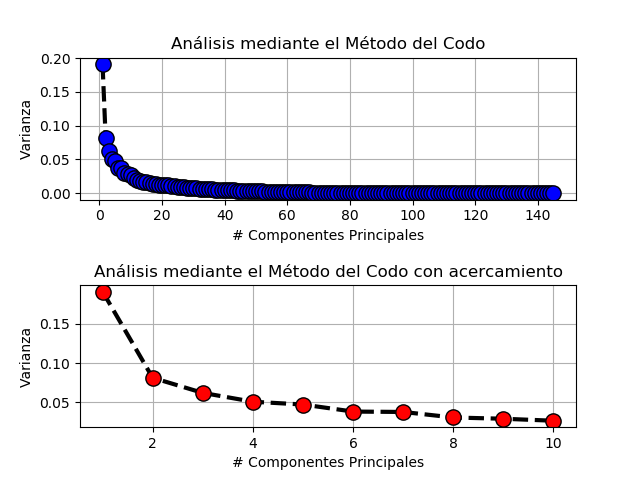

In [38]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

#df_edades = pd.read_csv("recursos/DatasetEdadesPreprocesado.csv", ';', low_memory=False)

# Se carga el archivo CSV con los datos preprocesados que creó anteriormente.
df_Preprocesado = df_b

# Cálculo PCA sin componentes.
componentesPrincipales = PCA().fit(df_Preprocesado)
varianza = componentesPrincipales.explained_variance_ratio_

num_CP= range(1, len(varianza) + 1)

# Gráfica de las muestra en 2D.

fig1 = plt.figure('Análisis mediante el gráfico del codo')
fig1.subplots_adjust(hspace=0.6, wspace=0.5)
ax = fig1.add_subplot(2, 1, 1)
ax.plot(num_CP, varianza, color='black', linestyle='dashed', linewidth = 3, 
         marker='o', markerfacecolor='blue', markersize=11)

ax.set_title('Análisis mediante el Método del Codo')
ax.set_xlabel('# Componentes Principales')
ax.set_ylabel('Varianza')
ax.grid(True)

num_CP= range(1, 11)
ax = fig1.add_subplot(2, 1, 2)
ax.plot(num_CP, varianza[:10:], color='black', linestyle='dashed', linewidth = 3, 
         marker='o', markerfacecolor='red', markersize=11)

ax.set_title('Análisis mediante el Método del Codo con acercamiento')
ax.set_xlabel('# Componentes Principales')
ax.set_ylabel('Varianza')
ax.grid(True)


plt.savefig('recursos/graficas/pcaCodo.png', dpi=300)
plt.show()

In [32]:
# El mejor componente para realizar reducción de dimensionalidad.
componentes = descubrirXElbow(varianza)
print("La mejor cantidad de componentes principales:", componentes)

La mejor cantidad de componentes principales: 3


In [7]:
salida_completo = df_b['covid19_positive']
df_completo = df_b.drop('covid19_positive', axis=1)
col_pca = []

for i in range(1, componentes + 1):
    col = "PC" + str(i)
    col_pca.append(col)

pca = PCA(componentes)
df_completo_pca = pca.fit_transform(df_completo)
df_completo_pca = pd.DataFrame(df_completo_pca, columns=col_pca)
com = pd.DataFrame(data=pca.components_, columns=df_completo.columns, index = col_pca)
for idx in com.index:
    print(str(idx) + ':\n', round(com.loc[str(idx)].nlargest(10), 3), '\n')

print("Correlaciónes Componentes-Salida:")
df_completo_pca.corrwith(salida_completo)

PC1:
 immigrant_native           0.340
race_white                 0.310
income                     0.293
insurance_yes              0.275
worried                    0.261
rate_reducing_mask_type    0.123
risk_infection             0.123
region_EU                  0.090
working_never              0.077
insurance_no               0.076
Name: PC1, dtype: float64 

PC2:
 sex_male              0.416
risk_infection        0.302
blood_type_unknown    0.187
heart_disease         0.174
diabetes              0.171
region_EU             0.168
covid19_symptoms      0.157
hypertension          0.145
age_80_90             0.124
covid19_contact       0.095
Name: PC2, dtype: float64 

PC3:
 sex_female            0.430
working_never         0.396
region_EU             0.162
age_70_80             0.137
age_80_90             0.135
country_GB            0.126
blood_type_unknown    0.122
other_chronic         0.098
opinion_mortality     0.096
risk_infection        0.092
Name: PC3, dtype: float64 

Correlac

PC1    0.328574
PC2    0.489966
PC3    0.148624
dtype: float64

<h4> Modelo Machine Learning orientado a la clasificación - Random Forest</h4>

In [86]:
# SPLITTING DATASET
from sklearn.model_selection import train_test_split

X = df_b.drop('covid19_positive', 1)  
y = df_b['covid19_positive']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0) 
#print(X_train.shape)
#print(X_test.shape)
#print(y_train.shape)
#print(y_test.shape)
#print(X_test)
print("Tamaño X_test: ", len(X_test.values))
X_train

Tamaño X_test:  130


,region_AF,region_AN,region_AS,region_EU,region_OC,region_SA,country_AM,country_AR,country_AT,country_AU,...,hiv_positive,hypertension,other_chronic,nursing_home,health_worker,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality
34,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.000000,0.789474,0.789474,1.0,0.067066
432,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.052632,0.052632,0.0,0.012465
399,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.0,0.483060
346,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.578947,0.578947,0.0,0.039825
542,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.684211,1.0,0.046064
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.000000,0.578947,0.578947,0.0,0.010394
359,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.333333,0.578947,0.789474,0.0,0.064648
192,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.0,0.035550
629,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.894737,0.578947,1.0,0.012518


In [93]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler, normalize
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix  
from sklearn.metrics import accuracy_score
import time
import datetime

x = range(1, min(X_train.shape) + 1)

listaAccuaracy = []
tiempos = []

tiempo_inicial = time.time()

for (comp) in x:
    tiempo_inicial_random = time.time()
    # Aplicamos PCA.
    pca = PCA(n_components=comp)
    X_train_PCA = pca.fit_transform(X_train)  
    X_test_PCA = pca.transform(X_test) 
    explained_variance = pca.explained_variance_ratio_  
        
     # Se realiza de nuevo el entrenamiento con Random Forest.
    clasificador = RandomForestClassifier(max_depth=15, random_state=0)  
    clasificador.fit(X_train_PCA, y_train)

    # Se realiza una nueva predicción en base al Test.
    y_pred = clasificador.predict(X_test_PCA)
    
    # Finalmente se evalúan los resultados. 
    cm = confusion_matrix(y_test, y_pred)
    listaAccuaracy.append(round(accuracy_score(y_test, y_pred, normalize=True), 5))
    tiempo_final_random = time.time()
    tiempos.append(tiempo_final_random - tiempo_inicial_random)
    

listaAccuaracy = np.array(listaAccuaracy)

print('Accuracy, '+str(componentes) + ' Componentes principales\n', 
     listaAccuaracy[componentes -1:componentes])

#print('\nLista de Accuracy, valores desde 20-30\n', listaAccuaracy[20:30])

maximo = np.amax(listaAccuaracy)
posicion = np.where(listaAccuaracy == np.amax(listaAccuaracy))
print('\nNúmero de componentes: ' + str((posicion[0]+1)))
print('\nMejor Accuracy: ' + str(maximo))

tiempo_final = time.time()
tiempo_ejecucion = (tiempo_final - tiempo_inicial)
print('\nTiempo de ejecución total: ', datetime.timedelta(seconds=tiempo_ejecucion))

Accuracy, 3 Componentes principales
 [0.86154]

Número de componentes: [23 64]

Mejor Accuracy: 1.0

Tiempo de ejecución total:  0:00:42.734151


In [25]:
# Imprimir arbol en una imágen png
from sklearn.tree import export_graphviz
from sklearn.tree import export_graphviz
import pydot

tree = clasificador.estimators_[50]

export_graphviz(tree, out_file = 'recursos/tree.dot', 
                feature_names = X_train.columns, rounded = True, precision = 1)

(graph, ) = pydot.graph_from_dot_file('recursos/tree.dot')
graph.write_png('recursos/tree.png')
#print( len(clasificador.estimators_))

<IPython.core.display.Javascript object>


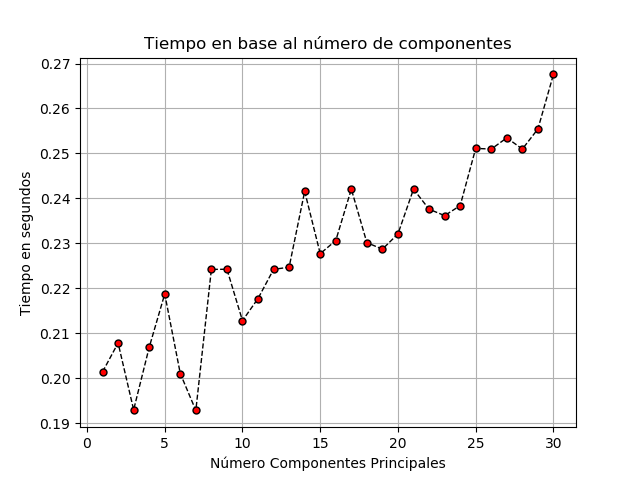

<IPython.core.display.Javascript object>


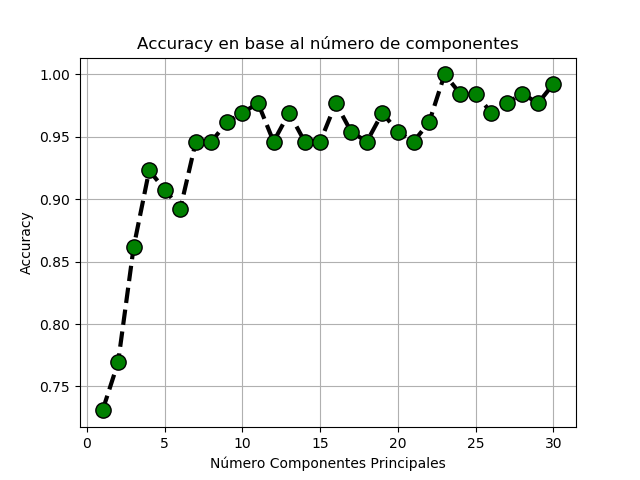

In [97]:
fig6 = plt.figure('Modelo orientado a clasificación (random forest)')
fig6.subplots_adjust(hspace=0.6, wspace=0.5)
ax = fig6.add_subplot(1, 1, 1)
ax.plot(x[:30:], tiempos[:30:], color='black', linestyle='dashed', linewidth = 1, 
         marker='o', markerfacecolor='red', markersize=5)

ax.set_title('Tiempo en base al número de componentes')
ax.set_xlabel('Número Componentes Principales')
ax.set_ylabel('Tiempo en segundos')
ax.grid(True)

plt.savefig('recursos/graficas/tiempo_random-forest.png', dpi=300)
plt.show()

fig8 = plt.figure('Gráfica Accuracy')
fig8.subplots_adjust(hspace=0.6, wspace=0.5)
ax = fig8.add_subplot(1, 1, 1)
ax.plot(x[:30:], listaAccuaracy[:30:], color='black', linestyle='dashed', linewidth = 3, 
         marker='o', markerfacecolor='green', markersize=11)

ax.set_title('Accuracy en base al número de componentes')
ax.set_xlabel('Número Componentes Principales')
ax.set_ylabel('Accuracy')
ax.grid(True)

plt.savefig('recursos/graficas/accuracy-plot.png', dpi=300)
plt.show()

In [64]:
from sklearn.tree import export_graphviz
from sklearn.tree import export_graphviz
import pydot

# SPLITTING DATASET
from sklearn.model_selection import train_test_split

X = df_completo_pca
y = salida_completo

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

x = range(1, min(X_train.shape) + 1)

clasificador = RandomForestClassifier(max_depth=15, random_state=0)  
clasificador.fit(X_train, y_train)
y_pred = clasificador.predict(X_test)
accuaracy = (round(accuracy_score(y_test, y_pred, normalize=True), 2))
print('Accuracy:', accuaracy)

# Imprimir arbol en una imágen png
tree = clasificador.estimators_[0]

export_graphviz(tree, out_file = 'recursos/tree.dot', 
                feature_names = X_train.columns, rounded = True, precision = 1)

(graph, ) = pydot.graph_from_dot_file('recursos/tree.dot')
graph.write_png('recursos/tree.png')

Accuracy: 0.87


<h4> Clustering </h4>

In [34]:
from sklearn.decomposition import PCA
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
import datetime
import time
from sklearn.utils.testing import ignore_warnings
from sklearn.exceptions import ConvergenceWarning

@ignore_warnings(category=ConvergenceWarning)

def getDistortions(X, k_max):
    K_range=range(2, k_max + 1, 1)
    distortions=[]
    KMeanTime = []
    for i in K_range:
        tiempo_inicial = time.time()
        kmeanModel = KMeans(n_clusters=i)
        kmeanModel.fit(X)
        r = kmeanModel.inertia_
        distortions.append(round(r, 4))
        tiempo_final = time.time()
        KMeanTime.append((tiempo_final - tiempo_inicial))    
    return distortions, KMeanTime

#Kmeans Clustering 
def doKmeans(X, nclust=2, init='k-means++', max_iter=100, 
             tol=0.0001, random_state=0, algorithm='full'):
    model = KMeans(nclust, init=init, random_state=random_state)
    model.fit(X)
    clust_labels = model.predict(X)
    cent = model.cluster_centers_
    return (clust_labels, cent)

Tiempo de ejecución total:  0:00:37.215883


<IPython.core.display.Javascript object>


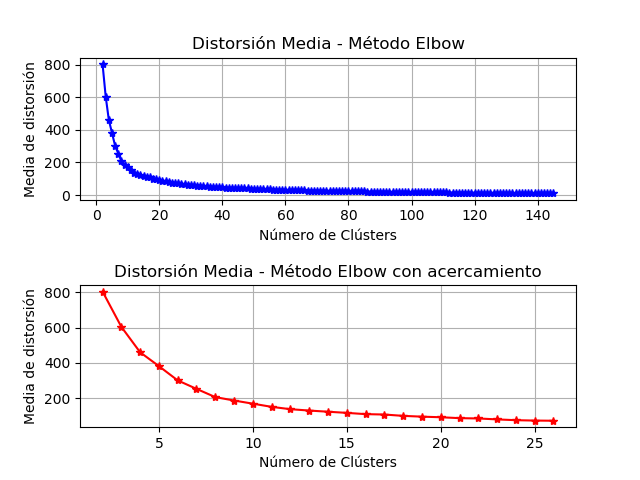

In [35]:
%matplotlib notebook
import matplotlib.pyplot as plt

k_max = min(df_b.shape)

df_s = df_completo_pca.values

tiempo_inicial = time.time()

distortions, distortionsTime = getDistortions(df_s, k_max)

tiempo_final = time.time()
tiempo_ejecucion = (tiempo_final - tiempo_inicial)
df_s = pd.DataFrame(data=df_s)

print('Tiempo de ejecución total: ', datetime.timedelta(seconds=tiempo_ejecucion))

K_range = np.arange(2, k_max + 1)
fig3=plt.figure('Distorsión-Media')
fig3.subplots_adjust(hspace=0.6, wspace=0.5)

ex = fig3.add_subplot(2,1,1)
ex.plot(K_range, distortions[:k_max - 1:1], 'b*-')

ex.grid(True)
ex.set_xlabel('Número de Clústers')
ex.set_ylabel('Media de distorsión')
ex.set_title('Distorsión Media - Método Elbow')

K_range = K_range[:25:]

ex = fig3.add_subplot(2,1,2)
ex.plot(K_range, distortions[:25:], 'r*-')

ex.grid(True)
ex.set_xlabel('Número de Clústers')
ex.set_ylabel('Media de distorsión')
ex.set_title('Distorsión Media - Método Elbow con acercamiento')

plt.savefig('recursos/graficas/distorsion-media.png', dpi=300)
plt.show()

In [37]:
K = descubrirXElbow(distortions, x_min=2, porcentaje=0.81)
#print(distortions)
print('\nEl mejor K: ', K)


El mejor K:  6


In [99]:
#pca = PCA(componentes)

#Esta es la matriz de componentes principales
#X_transformed = pca.fit_transform(df_b)

clust_labels, cent = doKmeans(df_completo_pca, K, 'k-means++', random_state=0)
kmeans_pca = pd.DataFrame(clust_labels, columns=['Grupos'])
print('Grupos con ', K, ' Clusters.\n')
kmeans_pca

Grupos con  6  Clusters.



,Grupos
0,5
1,5
2,2
3,1
4,1
...,...
645,4
646,4
647,3
648,4


<h4>Estadística descriptiva con los clusters con mayor cantidad de datos</h4>

Grupos
1    175
2    127
4    108
3     83
5     81
0     76
Name: Grupos, dtype: int64


<IPython.core.display.Javascript object>


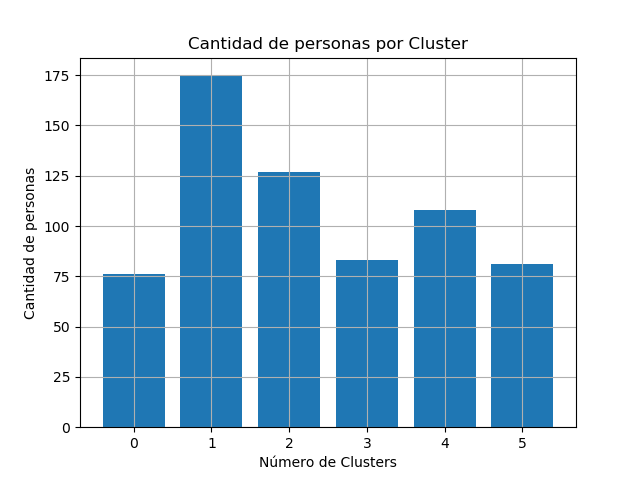

In [130]:
import random
# Realizar estadística descriptiva de cada cluster
df_cluster = pd.concat([df_b, kmeans_pca], axis=1)

UserGrupoK_pca=kmeans_pca.groupby(kmeans_pca.Grupos).Grupos.count()

UserGrupoK_pca=UserGrupoK_pca.sort_values(ascending=False, inplace=False, kind='quicksort')
print(UserGrupoK_pca)

x_range = UserGrupoK_pca.index

number_of_colors = len(x_range)

colors = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(number_of_colors)]

fig20 = plt.figure('Cantidad de muestras por Cluster')
ex = fig20.add_subplot(1,1,1)
ex.bar(x_range, UserGrupoK_pca)

ex.grid(True)
ex.set_ylabel('Cantidad de personas')
ex.set_xlabel('Número de Clusters')
ex.set_title('Cantidad de personas por Cluster')

plt.savefig('recursos/graficas/persona-cluster.png', dpi=300)
plt.show()

In [102]:
df_cluster_1 = df_cluster[(((df_cluster['Grupos'] == 1)))]

des_1 = df_cluster_1.describe()
var = df_cluster_1.var()
print('Media:\n\n', des_1.loc['mean'].nlargest(15))
print('\nDesviación Típica:\n\n', des_1.loc['std'].nlargest(15))
print('\nVarianza:\n\n', var.where(var != 0.0).nsmallest(15))

cov_positivo = df_cluster_1#[(df_cluster_1['covid19_positive'] == 1.0)]

correlacion_c1 = cov_positivo.corr()

print("\n------ Los atributos con correlación positiva ------\n")

print(correlacion_c1['covid19_positive'].nlargest(20))

print("\n------ Los atributos con correlación negativa ------\n")

print(correlacion_c1['covid19_positive'].nsmallest(19))


Media:

 insurance_blank              1.000000
race_other                   1.000000
Grupos                       1.000000
sex_female                   0.994286
immigrant_blank              0.994286
region_AN                    0.954286
country_US                   0.885714
age_60_70                    0.777143
ip_latitude                  0.746165
rate_reducing_risk_single    0.731429
rate_reducing_risk_house     0.692857
smoking_never                0.605714
rate_reducing_mask           0.593143
rate_government_action       0.565714
working_never                0.502857
Name: mean, dtype: float64

Desviación Típica:

 working_never              0.501427
smoking_never              0.490099
blood_type_op              0.479669
hypertension               0.467815
working_stopped            0.435079
age_60_70                  0.417357
blood_type_ap              0.405383
smoking_quit10             0.387659
other_chronic              0.387659
diabetes                   0.382885
age_70_80   

In [131]:
df_cluster_2 = df_cluster[(((df_cluster['Grupos'] == 2)))]
des_2 = df_cluster_2.describe()

print('Media:\n\n', des_2.loc['mean'].nlargest(15))
print('\nDesviación Típica:\n\n', des_2.loc['std'].nlargest(15))
print('\nVarianza:\n\n', df_cluster_2.var().nlargest(15))

correlacion_c2 = df_cluster_2.corr()

print("\n------ Los atributos con correlación positiva ------\n")

print(correlacion_c2['covid19_positive'].nlargest(20))

print("\n------ Los atributos con correlación negativa ------\n")

print(correlacion_c2['covid19_positive'].nsmallest(19))


Media:

 Grupos                                         2.000000
insurance_blank                                1.000000
immigrant_blank                                1.000000
sex_male                                       0.992126
race_other                                     0.992126
region_AN                                      0.913386
country_US                                     0.866142
ip_latitude                                    0.737303
age_60_70                                      0.732283
rate_reducing_risk_house                       0.677165
rate_reducing_risk_single                      0.671260
rate_government_action                         0.562992
smoking_never                                  0.503937
rate_government_control                        0.501969
rate_reducing_risk_single_social_distancing    0.500000
Name: mean, dtype: float64

Desviación Típica:

 smoking_never              0.501965
covid19_positive           0.496331
hypertension               0.4

In [132]:
df_cluster_4 = df_cluster[(((df_cluster['Grupos'] == 4)))]
des_4 = df_cluster_4.describe()

print('Media:\n\n', des_4.loc['mean'].nlargest(15))
print('\nDesviación Típica:\n\n', des_4.loc['std'].nlargest(15))
print('\nVarianza:\n\n', df_cluster_4.var().nlargest(15))


correlacion_c4 = df_cluster_4.corr()

print("\n------ Los atributos con correlación positiva ------\n")

print(correlacion_c4['covid19_positive'].nlargest(20))

print("\n------ Los atributos con correlación negativa ------\n")

print(correlacion_c4['covid19_positive'].nsmallest(19))

Media:

 Grupos                                         4.000000
region_AN                                      0.907407
insurance_yes                                  0.870370
immigrant_native                               0.870370
income                                         0.844907
country_US                                     0.842593
age_60_70                                      0.842593
race_white                                     0.833333
rate_reducing_mask                             0.748148
rate_reducing_risk_single_washing_hands        0.736111
rate_reducing_risk_single_social_distancing    0.726852
ip_latitude                                    0.716728
rate_reducing_risk_house_social_distancing     0.712963
worried                                        0.709259
rate_reducing_risk_house_washing_hands         0.706019
Name: mean, dtype: float64

Desviación Típica:

 working_never              0.493643
covid19_positive           0.489771
smoking_never              0.4

In [135]:
df_cluster_0 = df_cluster[(((df_cluster['Grupos'] == 0)))]
des_0 = df_cluster_0.describe()

print('Media:\n\n', des_0.loc['mean'].nlargest(15))
print('\nDesviación Típica:\n\n', des_0.loc['std'].nlargest(15))
print('\nVarianza:\n\n', df_cluster_0.var().nlargest(15))


correlacion_c0 = df_cluster_0.corr()

print("\n------ Los atributos con correlación positiva ------\n")

print(correlacion_c0['covid19_positive'].nlargest(20))

print("\n", correlacion_c0['risk_mortality'].nlargest(20))

print("\n------ Los atributos con correlación negativa ------\n")

print(correlacion_c0['covid19_positive'].nsmallest(19))

Media:

 sex_female                                     1.000000
working_never                                  0.894737
immigrant_native                               0.881579
race_white                                     0.828947
risk_infection                                 0.809418
covid19_positive                               0.802632
ip_latitude                                    0.720779
smoking_never                                  0.697368
income                                         0.690789
worried                                        0.689474
rate_reducing_risk_single_washing_hands        0.644737
rate_reducing_risk_single_social_distancing    0.631579
rate_reducing_risk_house_washing_hands         0.631579
rate_reducing_risk_house_social_distancing     0.621711
insurance_yes                                  0.578947
Name: mean, dtype: float64

Desviación Típica:

 region_AN             0.501751
country_US            0.500526
blood_type_unknown    0.497009
insurance

In [133]:
salida_cluster_1 = df_cluster_1['covid19_positive']
df_cluster_1_tmp = df_cluster_1.drop('covid19_positive', axis=1)
df_cluster_1_tmp = df_cluster_1_tmp.drop('Grupos', axis=1)

pca = PCA(3)
df_cluster_1_pca = pca.fit_transform(df_cluster_1_tmp)
df_cluster_1_pca = pd.DataFrame(df_cluster_1_pca, columns = ['PC1', 'PC2', 'PC3'])
com = pd.DataFrame(data=pca.components_, columns=df_cluster_1_tmp.columns, index = ['PC1', 'PC2', 'PC3'])
print('PC1:\n', round(com.loc['PC1'].nlargest(10), 3))
print('\nPC2:\n', round(com.loc['PC2'].nlargest(10), 3))
print('\nPC3:\n', round(com.loc['PC3'].nlargest(10), 3))

df_cluster_1_pca.corrwith(salida_cluster_1)

PC1:
 working_never     0.659
hypertension      0.368
age_70_80         0.198
diabetes          0.146
blood_type_ap     0.091
lung_disease      0.090
country_US        0.079
heart_disease     0.074
smoking_quit10    0.073
smoking_quit0     0.044
Name: PC1, dtype: float64

PC2:
 blood_type_op         0.532
age_70_80             0.381
smoking_quit10        0.231
opinion_mortality     0.136
opinion_infection     0.124
covid19_symptoms      0.080
rate_reducing_mask    0.070
lung_disease          0.069
working_never         0.063
compromised_immune    0.060
Name: PC2, dtype: float64

PC3:
 smoking_never        0.746
age_70_80            0.181
risk_infection       0.162
blood_type_op        0.154
covid19_symptoms     0.083
age_80_90            0.073
working_never        0.049
covid19_contact      0.047
opinion_infection    0.037
working_stopped      0.031
Name: PC3, dtype: float64


PC1   -0.184376
PC2    0.313054
PC3   -0.106722
dtype: float64

In [110]:
salida_cluster_2 = df_cluster_2['covid19_positive']
df_cluster_2_tmp = df_cluster_2.drop('covid19_positive', axis=1)
df_cluster_2_tmp = df_cluster_2_tmp.drop('Grupos', axis=1)

pca = PCA(componentes)
df_cluster_2_pca = pca.fit_transform(df_cluster_2_tmp)
df_cluster_2_pca = pd.DataFrame(df_cluster_2_pca, columns=['PC1', 'PC2', 'PC3'])
com = pd.DataFrame(data=pca.components_, columns=df_cluster_2_tmp.columns, index = ['PC1', 'PC2', 'PC3'])
print('PC1:\n', round(com.loc['PC1'].nlargest(10), 3))
print('\nPC2:\n', round(com.loc['PC2'].nlargest(10), 3))
print('\nPC3:\n', round(com.loc['PC3'].nlargest(10), 3))

df_cluster_2_pca.corrwith(salida_cluster_2)

PC1:
 risk_infection             0.533
working_travel critical    0.352
covid19_contact            0.305
covid19_symptoms           0.297
contacts_count             0.239
smoking_never              0.170
blood_type_unknown         0.116
compromised_immune         0.115
diabetes                   0.107
opinion_infection          0.105
Name: PC1, dtype: float64

PC2:
 age_70_80           0.484
smoking_quit10      0.272
working_stopped     0.235
heart_disease       0.190
diabetes            0.161
country_US          0.153
blood_type_op       0.093
region_AN           0.091
lung_disease        0.063
smoking_yeslight    0.059
Name: PC2, dtype: float64

PC3:
 blood_type_op              0.329
working_travel critical    0.244
working_never              0.166
contacts_count             0.159
smoking_quit10             0.144
asthma                     0.141
alcohol                    0.128
age_60_70                  0.127
smoking_quit5              0.120
covid19_symptoms           0.113
Name: PC

PC1    0.123711
PC2   -0.082749
PC3    0.222545
dtype: float64

In [111]:
salida_cluster_4 = df_cluster_4['covid19_positive']
df_cluster_4_tmp = df_cluster_4.drop('covid19_positive', axis=1)
df_cluster_4_tmp = df_cluster_4_tmp.drop('Grupos', axis=1)

pca = PCA(componentes)
df_cluster_4_pca = pca.fit_transform(df_cluster_4_tmp)
df_cluster_4_pca = pd.DataFrame(df_cluster_4_pca, columns=['PC1', 'PC2', 'PC3'])
com = pd.DataFrame(data=pca.components_, columns=df_cluster_4_tmp.columns, index = ['PC1', 'PC2', 'PC3'])
print('PC1:\n', round(com.loc['PC1'].nlargest(10), 3))
print('\nPC2:\n', round(com.loc['PC2'].nlargest(10), 3))
print('\nPC3:\n', round(com.loc['PC3'].nlargest(10), 3))

df_cluster_4_pca.corrwith(salida_cluster_4)

PC1:
 sex_female                                    0.486
working_never                                 0.209
smoking_quit10                                0.204
race_white                                    0.144
asthma                                        0.142
rate_government_spend                         0.110
rate_reducing_risk_house_social_distancing    0.100
blood_type_ap                                 0.099
insurance_yes                                 0.086
immigrant_native                              0.085
Name: PC1, dtype: float64

PC2:
 risk_infection             0.373
sex_female                 0.372
working_travel critical    0.303
smoking_never              0.186
opinion_infection          0.182
asthma                     0.150
age_60_70                  0.143
contacts_count             0.131
health_worker              0.130
blood_type_ap              0.119
Name: PC2, dtype: float64

PC3:
 age_60_70                              0.258
region_SA                        

PC1    0.447842
PC2   -0.211013
PC3    0.335562
dtype: float64

<h4> Visualización en 3D </h4>

Varianzas:
[1.689 0.717 0.547]

Porcentaje de varianza de cada dimensión con respecto a la varianza total:
[0.191 0.081 0.062]

Porcentaje acumulado de varianza:
[0.191 0.272 0.334]

Correlación
      0    1    2
0  1.0 -0.0  0.0
1 -0.0  1.0 -0.0
2  0.0 -0.0  1.0


<IPython.core.display.Javascript object>


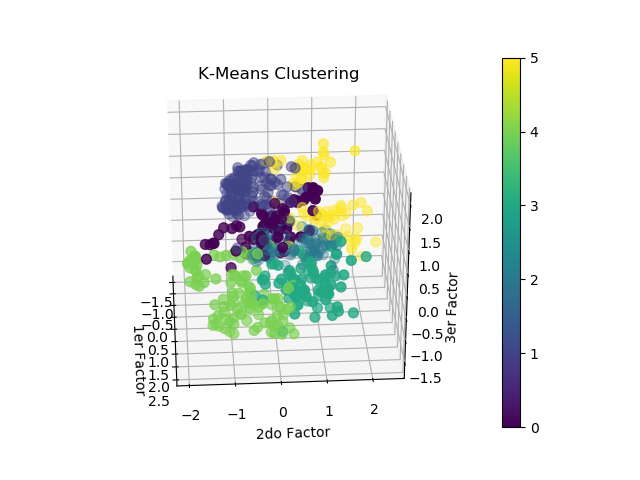

In [42]:
%matplotlib notebook

from mpl_toolkits import mplot3d
import matplotlib.pyplot as plt
from IPython.display import HTML
import matplotlib.animation as animation

num_components=3
pca = PCA(num_components)

#Esta es la matriz de componentes principales
X_transformed = pca.fit_transform(df_b)
eigenvalues = pca.explained_variance_

df_c = pd.DataFrame(data=X_transformed, columns = range(num_components))

print('Varianzas:')
print(eigenvalues.round(3))

explained_variance_ratio_=pca.explained_variance_ratio_

print('\nPorcentaje de varianza de cada dimensión con respecto a la varianza total:')
print(explained_variance_ratio_.round(3))

#Se obtiene el porcentaje acumulado de varianza
print('\nPorcentaje acumulado de varianza:')
explained_variance_ratio_cumsum=explained_variance_ratio_.cumsum()

print(explained_variance_ratio_cumsum.round(3))

correl=df_c.corr()
correl=round(correl,5)
print('\nCorrelación\n', correl)

fig4 = plt.figure("K-Means Clustering 3D")
ax = fig4.add_subplot(1,1,1, projection='3d')

def init():
    scatter = ax.scatter(df_c[0], df_c[1], df_c[2], 
                         c=kmeans_pca['Grupos'], s=50)
    ax.set_title('K-Means Clustering')
    ax.set_xlabel('1er Factor')
    ax.set_ylabel('2do Factor')
    ax.set_zlabel('3er Factor')
    plt.colorbar(scatter)
    plt.savefig('recursos/graficas/k-means-clustering-pca-3D-PCA.png', dpi=300)
    return fig4,

def animate(i):
    ax.view_init(elev=30., azim=3.6*i)
    return fig4

def start():
    ani = animation.FuncAnimation(fig4, animate, init_func=init,
                               frames=100, interval=100, blit=True)
    return ani

HTML(start().to_jshtml())

<h4> Visualización en 2D </h4>

Varianzas:
[1.689 0.717]

Porcentaje de varianza de cada dimensión con respecto a la varianza total:
[0.191 0.081]

Porcentaje acumulado de varianza:
[0.191 0.272]

Correlación
      0    1
0  1.0 -0.0
1 -0.0  1.0


<IPython.core.display.Javascript object>


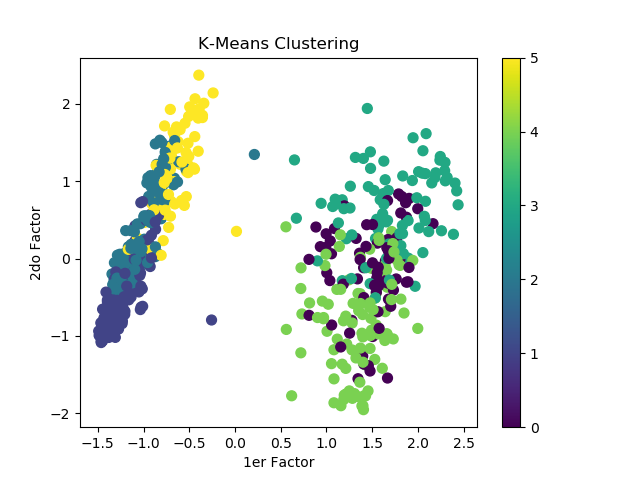

In [43]:
num_components=2
pca = PCA(num_components)

#Esta es la matriz de componentes principales
X_transformed = pca.fit_transform(df_b)
eigenvalues = pca.explained_variance_

df_c = pd.DataFrame(data=X_transformed, columns = range(num_components))

print('Varianzas:')
print(eigenvalues.round(3))

explained_variance_ratio_=pca.explained_variance_ratio_

print('\nPorcentaje de varianza de cada dimensión con respecto a la varianza total:')
print(explained_variance_ratio_.round(3))

#Se obtiene el porcentaje acumulado de varianza
print('\nPorcentaje acumulado de varianza:')
explained_variance_ratio_cumsum=explained_variance_ratio_.cumsum()

print(explained_variance_ratio_cumsum.round(3))

correl=df_c.corr()
correl=round(correl, 5)
print('\nCorrelación\n', correl)

fig5 = plt.figure("K-Means Clustering 2D")
ax = fig5.add_subplot(1,1,1)

scatter1 = ax.scatter(df_c[0], df_c[1], 
                         c=kmeans_pca['Grupos'], s=50)
ax.set_title('K-Means Clustering')
ax.set_xlabel('1er Factor')
ax.set_ylabel('2do Factor')
plt.colorbar(scatter1)
plt.savefig('recursos/graficas/k-means-clustering-pca-2D.png', dpi=300)
plt.show()

<h4> Extra: Visualización en 2D con 10 Clusters  </h4>

<IPython.core.display.Javascript object>


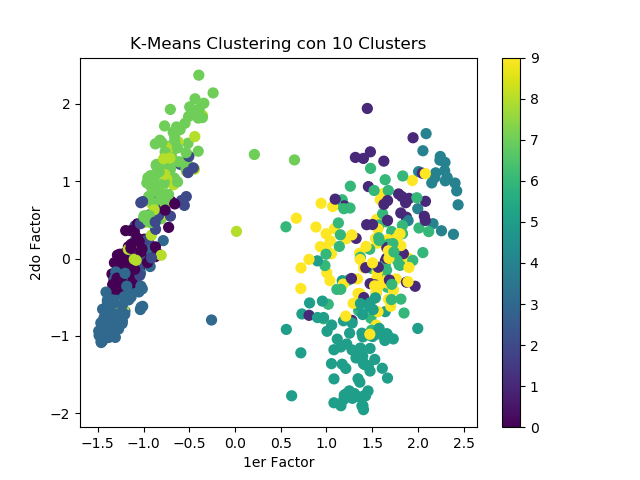

In [44]:
K_d = 10
num_components=2
pca = PCA(num_components)

#Esta es la matriz de componentes principales
X_transformed = pca.fit_transform(df_b)
eigenvalues = pca.explained_variance_

df_c = pd.DataFrame(data=X_transformed, columns = range(num_components))

clust_labels, cent = doKmeans(df_b, K_d, 'k-means++', random_state=0)
kmeans = pd.DataFrame(clust_labels, columns=['Grupos'])

fig7 = plt.figure("K-Means Clustering 2D Disperso")
ax = fig7.add_subplot(1,1,1)

scatter1 = ax.scatter(df_c[0], df_c[1], 
                         c=kmeans['Grupos'], s=50)
ax.set_title('K-Means Clustering con ' +  str(K_d) + ' Clusters')
ax.set_xlabel('1er Factor')
ax.set_ylabel('2do Factor')
plt.colorbar(scatter1)
plt.savefig('recursos/graficas/k-means-clustering-pca-2D-10-clusters.png', dpi=300)
plt.show()

<h4> Extra: Visualización en 3D con 10 Clusters  </h4>

<IPython.core.display.Javascript object>


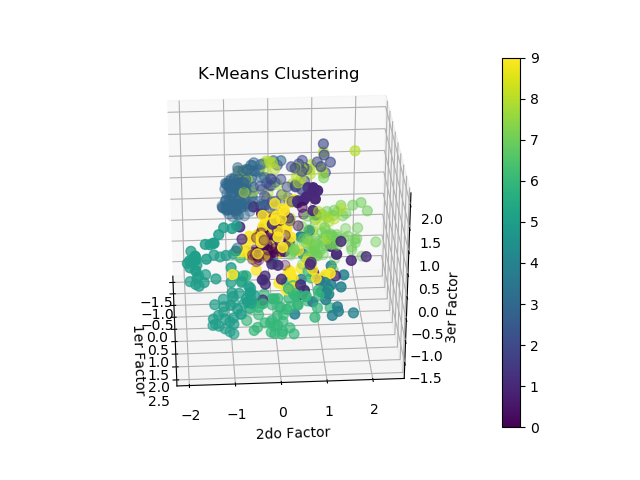

In [45]:
%matplotlib notebook

from mpl_toolkits import mplot3d
import matplotlib.pyplot as plt
from IPython.display import HTML
import matplotlib.animation as animation

K_d = 10
num_components=3
pca = PCA(num_components)

#Esta es la matriz de componentes principales
X_transformed = pca.fit_transform(df_b)
eigenvalues = pca.explained_variance_

df_c = pd.DataFrame(data=X_transformed, columns = range(num_components))

clust_labels, cent = doKmeans(df_b, K_d, 'k-means++', random_state=0)
kmeans = pd.DataFrame(clust_labels, columns=['Grupos'])

figA10 = plt.figure("K-Means Clustering 3D con 10 Clusters")
ax = figA10.add_subplot(1,1,1, projection='3d')

def init():
    scatter = ax.scatter(df_c[0], df_c[1], df_c[2], 
                         c=kmeans['Grupos'], s=50)
    ax.set_title('K-Means Clustering')
    ax.set_xlabel('1er Factor')
    ax.set_ylabel('2do Factor')
    ax.set_zlabel('3er Factor')
    plt.colorbar(scatter)
    plt.savefig('recursos/graficas/k-means-clustering-pca-3D-PCA-10-clusters.png', dpi=300)
    return figA10,

def animate(i):
    ax.view_init(elev=30., azim=3.6*i)
    return figA10

def start():
    ani = animation.FuncAnimation(figA10, animate, init_func=init,
                               frames=100, interval=100, blit=True)
    return ani

HTML(start().to_jshtml())